<a href="https://colab.research.google.com/github/CatsandCoffee/DataScienceMentorship/blob/main/DataScienceMentorship.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Getting dataset from Rig State Raw into python 



In [19]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [20]:
data = pd.read_csv("Rig_State_Data.csv")

In [21]:
# Clean column headers
def clean_column_headers(df):
    if ('Unnamed: 0' in df.columns):
        df=df.drop('Unnamed: 0',axis='columns')
    df.columns = (df.columns
                  .str.replace(".","_")
                  .str.replace("`","_")
                  .str.replace(" ","_")
                  .str.replace(":","")
                  .str.lower()
                 )
    return df

data = clean_column_headers(data)

In [22]:
# Dataset Information
print(data.info())
data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8029 entries, 0 to 8028
Data columns (total 21 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   well_name            8029 non-null   object 
 1   wellbore_name        8029 non-null   object 
 2   operation_name       8029 non-null   object 
 3   rig_name             8029 non-null   object 
 4   start_date           8029 non-null   object 
 5   start_time           8029 non-null   object 
 6   end_time             8029 non-null   object 
 7   tour                 8029 non-null   object 
 8   duration_(s)         8029 non-null   object 
 9   duration_(hr)        8029 non-null   float64
 10  rig_state            8029 non-null   int64  
 11  internal_rig_state   8029 non-null   int64  
 12  hole_start_depth_md  8029 non-null   object 
 13  hole_end_depth_md    8029 non-null   object 
 14  bit_start_depth_md   8029 non-null   object 
 15  bit_end_depth_md     8029 non-null   o

,well_name,wellbore_name,operation_name,rig_name,start_date,start_time,end_time,tour,duration_(s),duration_(hr),...,internal_rig_state,hole_start_depth_md,hole_end_depth_md,bit_start_depth_md,bit_end_depth_md,description,class_code,phase_code,task_code,user_code
0,Loris 41,Loris 41,RSD,Offshore Rig 1,1/7/2019,11:32:10 AM,11:32:20 AM,Day Tour,10,0.003,...,23,"1,100.00","1,100.00",45.3,45.3,[23] Rotating,P,DR,P50,NaN
1,Loris 41,Loris 41,RSD,Offshore Rig 1,1/7/2019,12:10:40 PM,12:43:50 PM,Day Tour,"1,990",0.553,...,31,"1,100.00","1,100.00",74.5,84.9,[31] In Slips - Casing,P,CSG,RIO,NaN
2,Loris 41,Loris 41,RSD,Offshore Rig 1,1/7/2019,12:10:40 PM,2:21:20 PM,Day Tour,"7,840",2.178,...,5,"1,100.00","1,100.00",74.5,281.2,[5] Casing Run,P,CSG,RIO,NaN
3,Loris 41,Loris 41,RSD,Offshore Rig 1,1/7/2019,12:11:25 PM,12:40:15 PM,Day Tour,"1,730",0.481,...,44,"1,100.00","1,100.00",74.7,85,[44] Slips to Slips - Casing,P,CSG,P23,NaN
4,Loris 41,Loris 41,RSD,Offshore Rig 1,1/7/2019,12:11:30 PM,12:40:50 PM,Day Tour,"1,760",0.489,...,47,"1,100.00","1,100.00",74.5,81.3,[47] Casing Block (Up/Down),P,NaN,NaN,NaN


       duration_(hr)    rig_state  internal_rig_state  user_code
count    8029.000000  8029.000000         8029.000000        0.0
mean        0.072137    20.112841           20.112841        NaN
std         0.117960    17.231764           17.231764        NaN
min         0.000000     1.000000            1.000000        NaN
25%         0.006000     4.000000            4.000000        NaN
50%         0.029000    23.000000           23.000000        NaN
75%         0.128000    38.000000           38.000000        NaN
max         3.107000    51.000000           51.000000        NaN


,well_name,wellbore_name,operation_name,rig_name,start_date,start_time,end_time,tour,duration_(s),hole_start_depth_md,hole_end_depth_md,bit_start_depth_md,bit_end_depth_md,description,class_code,phase_code,task_code
count,8029,8029,8029,8029,8029,8029,8029,8029,8029,8029,8029,8029,8029,8029,8029,7432,7432
unique,1,1,1,1,13,5663,5649,2,326,1860,1875,4715,4610,28,2,2,21
top,Loris 41,Loris 41,RSD,Offshore Rig 1,1/8/2019,7:00:00 PM,7:00:00 PM,Night Tour,605,"2,910.00","2,910.00",1,1,[4] Circulating,P,DR,CIM
freq,8029,8029,8029,8029,1186,28,28,4017,1366,971,971,35,41,2350,7941,7012,2432


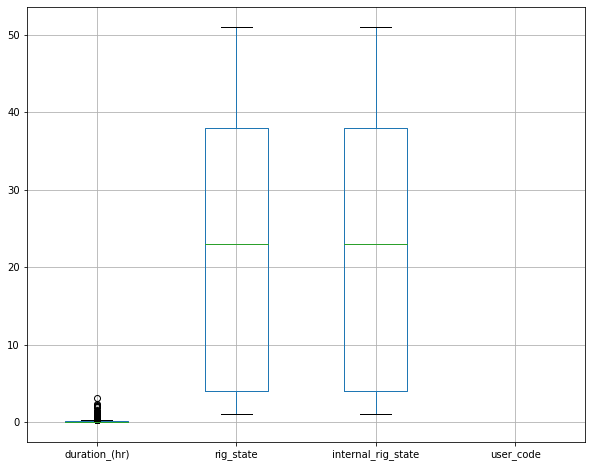

In [23]:
# Dataset Description
data.boxplot(figsize=(10, 8))
print(data.describe())
data.describe(include='object')

Total and Percentage of NaN:
             Total     Percent
user_code    8029  100.000000
phase_code    597    7.435546
task_code     597    7.435546


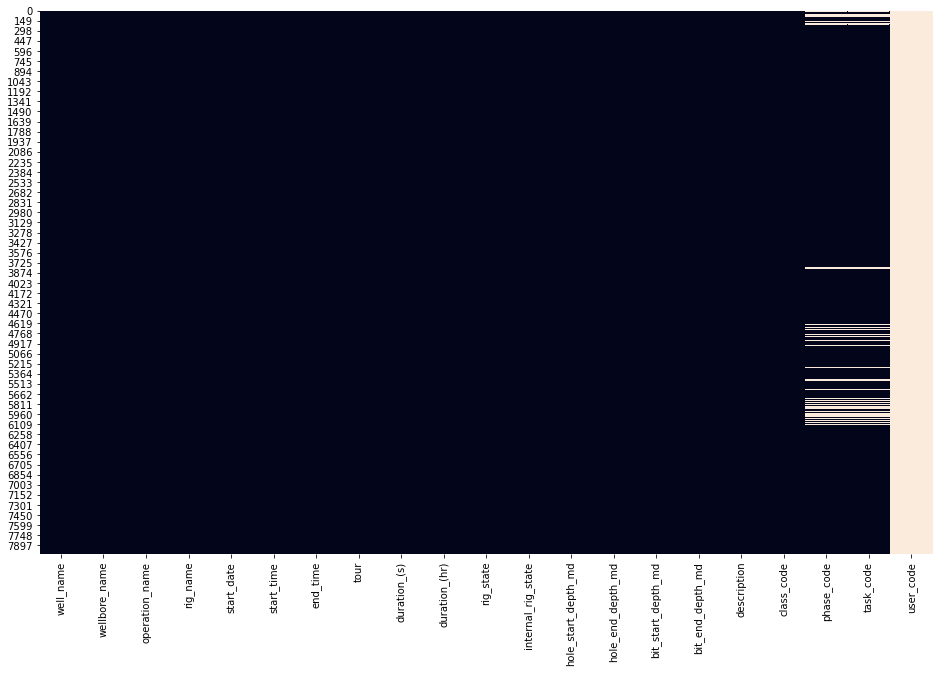

In [7]:
# Find Missing Data
def missing_data(df):
    '''
    Checks df for nulls, displays size & location
    '''
    if df.isnull().sum().sum() > 0: #if any missing value is found after summing total values in all columns
        mask_total = df.isnull().sum().sort_values(ascending=False) 
        total = mask_total[mask_total > 0]

        mask_percent = (df.isnull().mean().sort_values(ascending=False))*100 
        percent = mask_percent[mask_percent > 0] 

        missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
    
        print(f'Total and Percentage of NaN:\n {missing_data}')
        # Display missing data in heat map
        plt.figure(figsize=(16, 10))
        sns.heatmap(data.isnull(), cbar=False)
    else: 
        print('No NaN found.')
        
missing_data(data)


## Convert to proper data types and explore

In [24]:
# Remove commas from numerical columns
data = data.replace(',', '', regex=True)

In [25]:
# Convert columns to proper dtypes
convert_dict = {'duration_(s)':int, 'rig_state':str, 'internal_rig_state':str, 'hole_start_depth_md':float, 'hole_end_depth_md':float, 'bit_start_depth_md':float, 'bit_end_depth_md':float, }
data = data.astype(convert_dict)

In [26]:
# Concactenante date and time columns
data['start'] = data['start_date'] + ' ' + data['start_time']
data['end'] = data['start_date'] + ' ' + data['end_time']

In [27]:
# Convert date/time columns to datetime dtype
data.start = pd.to_datetime(data.start, errors='coerce')
data.end = pd.to_datetime(data.end, errors='coerce')

In [28]:
# Confirm date/time columns are correct
data[['start_date', 'start_time', 'end_time', 'start', 'end']].sample(10)

,start_date,start_time,end_time,start,end
5170,1/14/2019,2:22:05 AM,2:22:55 AM,2019-01-14 02:22:05,2019-01-14 02:22:55
3990,1/11/2019,5:33:00 PM,5:39:00 PM,2019-01-11 17:33:00,2019-01-11 17:39:00
4477,1/12/2019,10:52:30 AM,10:55:40 AM,2019-01-12 10:52:30,2019-01-12 10:55:40
6394,1/17/2019,10:50:35 PM,10:53:10 PM,2019-01-17 22:50:35,2019-01-17 22:53:10
7373,1/19/2019,4:52:35 AM,4:52:40 AM,2019-01-19 04:52:35,2019-01-19 04:52:40
3231,1/10/2019,6:48:25 PM,6:48:30 PM,2019-01-10 18:48:25,2019-01-10 18:48:30
7142,1/18/2019,9:04:00 PM,9:14:05 PM,2019-01-18 21:04:00,2019-01-18 21:14:05
4491,1/12/2019,11:19:45 AM,11:21:05 AM,2019-01-12 11:19:45,2019-01-12 11:21:05
36,1/7/2019,2:08:00 PM,2:08:25 PM,2019-01-07 14:08:00,2019-01-07 14:08:25
7123,1/18/2019,8:36:10 PM,8:50:50 PM,2019-01-18 20:36:10,2019-01-18 20:50:50


In [29]:
# Drop non relevant/useable data
data = data.drop(['operation_name', 'user_code', 'start_date', 'start_time', 'end_time'], axis='columns')

In [30]:
# Confirm dtypes and data
print(data.info())
data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8029 entries, 0 to 8028
Data columns (total 18 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   well_name            8029 non-null   object        
 1   wellbore_name        8029 non-null   object        
 2   rig_name             8029 non-null   object        
 3   tour                 8029 non-null   object        
 4   duration_(s)         8029 non-null   int32         
 5   duration_(hr)        8029 non-null   float64       
 6   rig_state            8029 non-null   object        
 7   internal_rig_state   8029 non-null   object        
 8   hole_start_depth_md  8029 non-null   float64       
 9   hole_end_depth_md    8029 non-null   float64       
 10  bit_start_depth_md   8029 non-null   float64       
 11  bit_end_depth_md     8029 non-null   float64       
 12  description          8029 non-null   object        
 13  class_code           8029 non-nul

,well_name,wellbore_name,rig_name,tour,duration_(s),duration_(hr),rig_state,internal_rig_state,hole_start_depth_md,hole_end_depth_md,bit_start_depth_md,bit_end_depth_md,description,class_code,phase_code,task_code,start,end
0,Loris 41,Loris 41,Offshore Rig 1,Day Tour,10,0.003,23,23,1100.0,1100.0,45.3,45.3,[23] Rotating,P,DR,P50,2019-01-07 11:32:10,2019-01-07 11:32:20
1,Loris 41,Loris 41,Offshore Rig 1,Day Tour,1990,0.553,31,31,1100.0,1100.0,74.5,84.9,[31] In Slips - Casing,P,CSG,RIO,2019-01-07 12:10:40,2019-01-07 12:43:50
2,Loris 41,Loris 41,Offshore Rig 1,Day Tour,7840,2.178,5,5,1100.0,1100.0,74.5,281.2,[5] Casing Run,P,CSG,RIO,2019-01-07 12:10:40,2019-01-07 14:21:20
3,Loris 41,Loris 41,Offshore Rig 1,Day Tour,1730,0.481,44,44,1100.0,1100.0,74.7,85.0,[44] Slips to Slips - Casing,P,CSG,P23,2019-01-07 12:11:25,2019-01-07 12:40:15
4,Loris 41,Loris 41,Offshore Rig 1,Day Tour,1760,0.489,47,47,1100.0,1100.0,74.5,81.3,[47] Casing Block (Up/Down),P,NaN,NaN,2019-01-07 12:11:30,2019-01-07 12:40:50


array([[<AxesSubplot:title={'center':'duration_(s)'}>,
        <AxesSubplot:title={'center':'duration_(hr)'}>],
       [<AxesSubplot:title={'center':'hole_start_depth_md'}>,
        <AxesSubplot:title={'center':'hole_end_depth_md'}>],
       [<AxesSubplot:title={'center':'bit_start_depth_md'}>,
        <AxesSubplot:title={'center':'bit_end_depth_md'}>]], dtype=object)

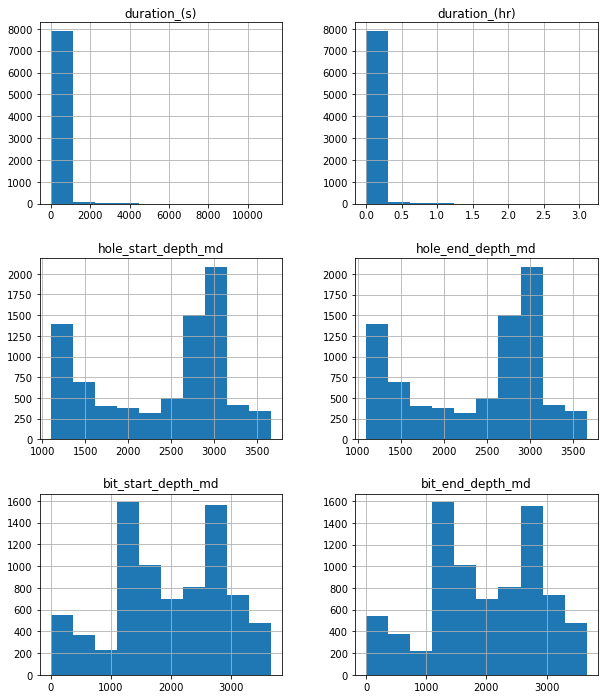

In [31]:
# Distribution of Numerical data
data.select_dtypes(include=['number']).hist(figsize= (10,12))

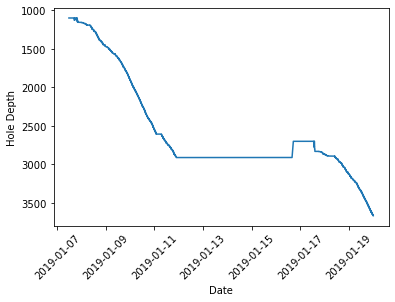

In [32]:
# Initial Vizz
plt.plot(data['start'], data['hole_end_depth_md'])
plt.xticks(rotation=45)
plt.gca().invert_yaxis()
plt.xlabel('Date')
plt.ylabel('Hole Depth')
plt.show()